# Find fish in frames
It export frames from the video then analyse them by using [Microsoft Cognitive Services, Computer Vision API](https://azure.microsoft.com/en-us/services/cognitive-services/computer-vision/) to find fish.
Currently, it exports a frame every 2 second, you can change the value of `export_ps=2` to change the export rate


## Notes to run the notebook
1. You need to update the subscription_key


In [45]:
%matplotlib inline

import os
from matplotlib import figure
from PIL import Image
from matplotlib import pyplot as plt
import base64
import json
import pandas as pd
import numpy as np
import cv2
import requests
import math
print('cv2 version:',cv2.__version__)

cv2 version: 3.4.0


In [2]:
def displayimagefrompath(imagepath,imagetitle):
    image_rgb = Image.open(imagepath)
    displayimage(image_rgb,imagetitle)

In [53]:
def displayimage(image,imagetitle):
    
    image_rgb = image
    image_grey=image_rgb.convert('L')
    f, (ax1, ax2) = plt.subplots(1, 2,figsize=(15,5))
    plt.title(imagetitle)
    ax1.set_title(imagetitle )
    ax1.imshow(image_rgb)
    ax2.set_title(imagetitle )
    ax2.imshow(np.asarray(image_grey), cmap='gray')
    
    plt.show()

In [4]:
def analyse(imagepath):
    
    # Replace <Subscription Key> with your valid subscription key.
    subscription_key = "<Subscription Key>"
    assert subscription_key

    # You must use the same region in your REST call as you used to get your
    # subscription keys. For example, if you got your subscription keys from
    # westus, replace "westcentralus" in the URI below with "westus".
    #
    # Free trial subscription keys are generated in the westcentralus region.
    # If you use a free trial subscription key, you shouldn't need to change
    # this region.
    
    vision_base_url = "https://westus.api.cognitive.microsoft.com/vision/v2.0/"
    api_url = vision_base_url + "analyze"
    
    headers = {
        # Request headers
        'Content-Type': 'application/octet-stream',
        'Ocp-Apim-Subscription-Key': subscription_key,
    }

    params   = {'visualFeatures': 'Tags,Description'}
    
    img_data=[]
    with open(imagepath, 'rb') as f:
        img_data = f.read()
        
    response = requests.post(api_url,params=params,headers=headers,data=img_data)
    
    try:
          response.raise_for_status()
    except:
        print(response)
        print(response.json())
        print('error:',imagepath)
     
    analysis = response.json()
    return analysis
    


In [5]:
def makedir(dir):
    try:
        if not os.path.exists(dir):
            os.makedirs(dir)
    except OSError:
        print ('Error: Creating directory ' + dir)



In [6]:
def exportframes(videoPath,outputpath,export_ps=2):
    
    print('exportig frames to %s' % (outputpath) )
    vidcap = cv2.VideoCapture(videoPath)
    success,np_image = vidcap.read()
    fps=vidcap.get(cv2.CAP_PROP_FPS)

    #number of frames to export  second
    fpsexport=fps* export_ps

    print('exporting frame every %s second' %(export_ps))
    count = 0
    success = True
    while success:
        if (count % fpsexport) ==0:
            tmpimagepath=os.path.join(outputpath,'frame_%d.jpg' % count).replace('\\','/') 
            cv2.imwrite(tmpimagepath, np_image)     # save frame as JPEG file
        success,np_image = vidcap.read()
        count += 1
        

    print('exporting finished....')

In [55]:
def analyseframes(outputpath):
    
    
    print('analysing exported frames from %s' %(outputpath))
    
    frames =[]
    tags =[]
    texts =[]
    imagepaths =[]
    confidences=[]
    
    for (dirpath, dirnames, filenames) in os.walk(outputpath):
        for filename in filenames:
            if filename.endswith('.jpg'): 
                imagepath = os.path.join(dirpath, filename).replace('\\','/') 
                #print(imagepath)
                frame = filename.split('.')[0].replace('frame_','')
                result=analyse(imagepath)
                #print ('%s frame - %s ' %(frame,imagepath))
                #print(result)
                if ('tags' in result):
                    alltagnames=[x['name'] for x in result['tags']]
                    if ('description' in result 
                        and 'captions' in result['description'] 
                        and len(result['description']['captions'])>0):
                        text=result['description']['captions'][0]['text']
                        confidence=result['description']['captions'][0]['confidence']
                    else:
                        text=""
                        confidence=""
                    frames.append(frame)
                    tags.append(' '.join(alltagnames))
                    texts.append(text)
                    imagepaths.append(imagepath)
                    confidences.append(confidence)


    np_frames =np.array(frames)
    np_tags =np.array(tags)
    np_texts =np.array(texts)
    np_imagepaths =np.array(imagepaths)
    np_confidences=np.array(confidences)

    d = {'frame': np_frames, 'tags': np_tags, 'text':np_texts, 'imagepath':np_imagepaths,'confidence':np_confidences}

    df = pd.DataFrame(data=d)
    
    print('analysing finished....')
    return df

    

In [97]:
def displayresultofanalysedframes(df):
    for row in df.itertuples():
        displayimagefrompath(row.imagepath,'frame:%s %s %s' %(row.frame,row.text , '%.2f%%' % (row.confidence *100) if not math.isnan(row.confidence) else '') )

In [9]:
def getexportfolderpath(videoPath,exportPath):
    if not os.path.exists(videoPath):
        raise ValueError('video path is invalid',videoPath)
    videofile = os.path.basename(videoPath)  # os independent
    videoname = videofile.split('.')[0]
    outputpath=os.path.join(exportPath,videoname).replace('\\','/')
    return outputpath

# Extract frames from Video

In [102]:
#video path
videofilePath='./videos/video1.mp4'
exportPath='./exported frames'
outputpath=getexportfolderpath(videofilePath,exportPath)
makedir(exportPath)
export_ps=5
exportframes(videofilePath,outputpath,export_ps)  

exportig frames to ./exported frames/video1
exporting frame every 5 second
exporting finished....


# Analysing the extracted frames

analysing exported frames from ./exported frames/video1
analysing finished....
35 frames analysed
32 frames detected with fish


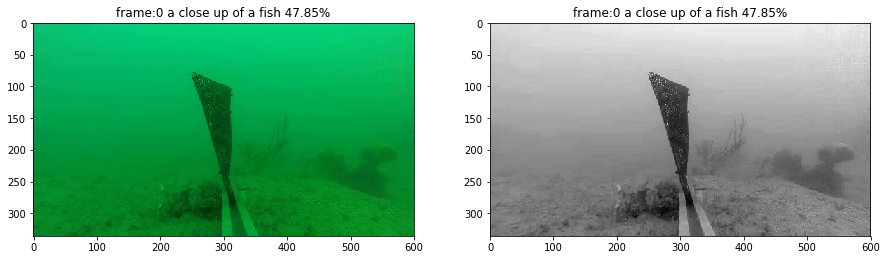

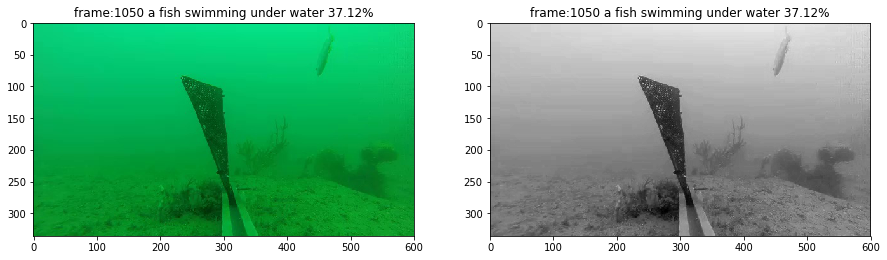

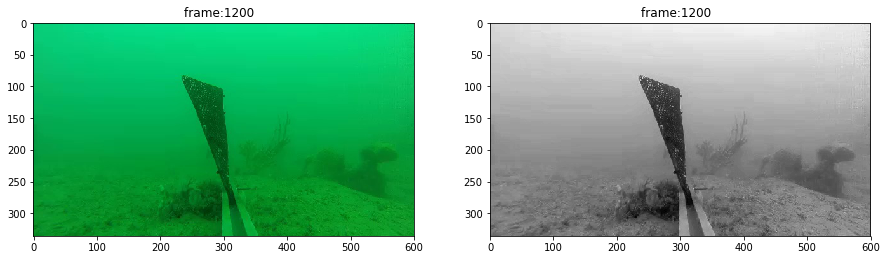

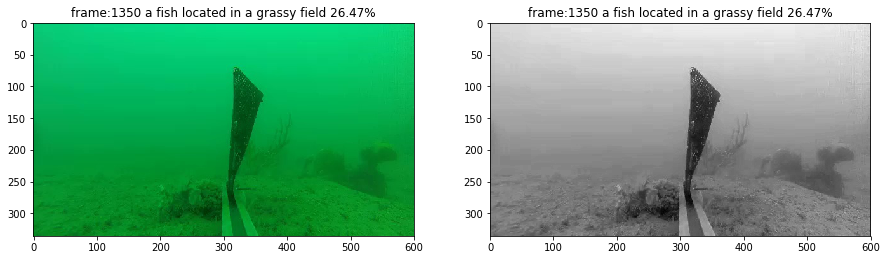

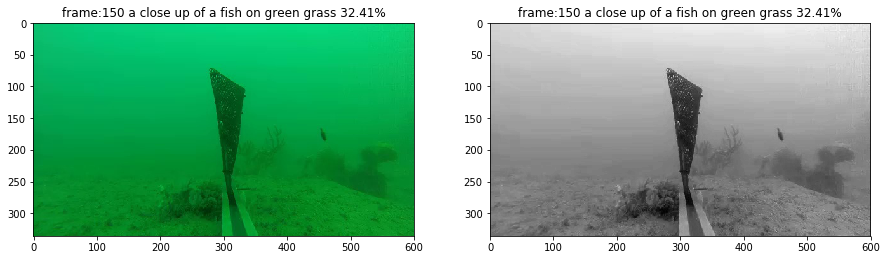

...

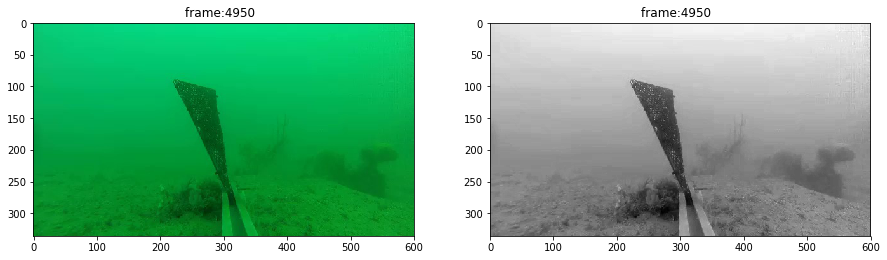

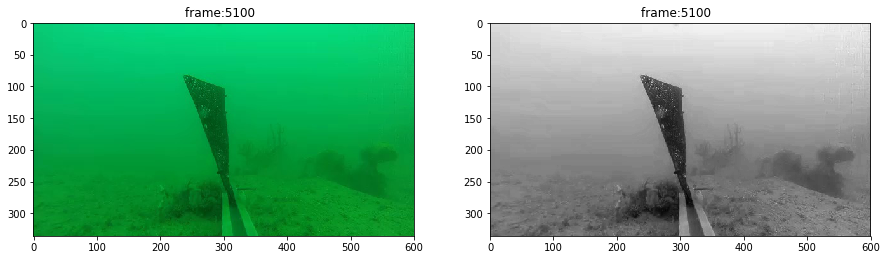

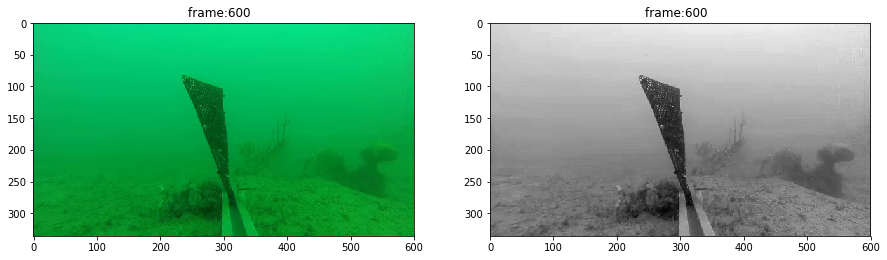

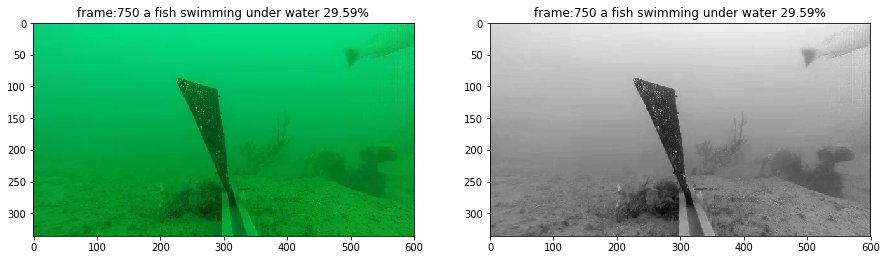

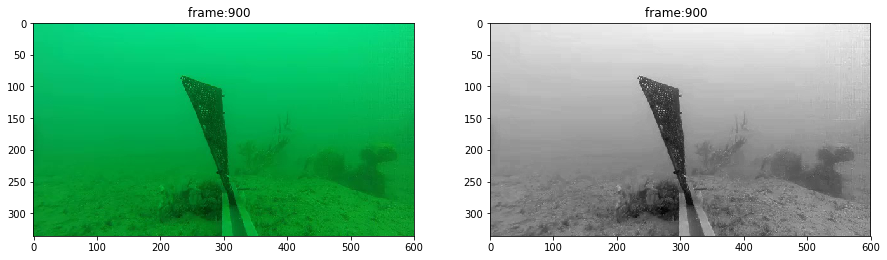

In [103]:
df=analyseframes(outputpath)
df['confidence'] =pd.to_numeric( df['confidence'])
total_rows,total_col= df.shape
print('%s frames analysed' % total_rows)
df.to_csv(os.path.join (outputpath,'result.csv'))
result_fish=df[df['tags'].str.contains('fish')]
fish_rows,fish_col= result_fish.shape
print('%s frames detected with fish' % fish_rows)
result_fish.to_csv(os.path.join (outputpath,'result_fish.csv'))
displayresultofanalysedframes(result_fish)  

# Manual validations
Sometimes you might like to check a specific frame or export range frames to have better dataset
I wanted to have more frames with school of fish 
I manually observed the images and export frames close to the frame that had school of fish in it

In [104]:
def getspecificframe(frame,videoPath):
    
    if(not os.path.exists(videoPath)):
        raise ValueError("cannot find the video file")
        
    vidcap = cv2.VideoCapture(videoPath)
    success,np_image = vidcap.read()
    count = 0
    if(success):
        while success:
            if count == frame:
                image = Image.fromarray(np_image)
                return image
            success,np_image = vidcap.read()
            count += 1

    raise ValueError('frame wasn\'t in the video')

In [105]:
def getframes(framefrom,frameto,videoPath,export_fps=5):
    print('return frames from %d to %d with export rate of %d frame per second' %(framefrom, frameto,export_fps))
    frames={}
    vidcap = cv2.VideoCapture(videoPath)
    success,np_image = vidcap.read()
    count = 0
    if(success):
        while success:
            if  count in np.arange(framefrom,frameto+1) and count % export_fps ==0:
                frames[count]= Image.fromarray(np_image)
            if count>frameto+1:
                return frames
            success,np_image = vidcap.read()
            count += 1

    raise ValueError('frame wasn\'t in the video')

In [106]:
def saveframes(images,outputpath):
    makedir(outputpath)
    for frame,image in images.items():
        tmpimagepath=os.path.join(outputpath,'frame_%d.jpg' % frame).replace('\\','/') 
        image.save(tmpimagepath, "JPEG") # save frame as JPEG file

In [107]:
def saveframe(frame,image,outputpath):
    makedir(outputpath)
    tmpimagepath=os.path.join(outputpath,'frame_%d.jpg' % frame).replace('\\','/') 
    image.save(tmpimagepath, "JPEG") # save frame as JPEG file

## look up and export a frame

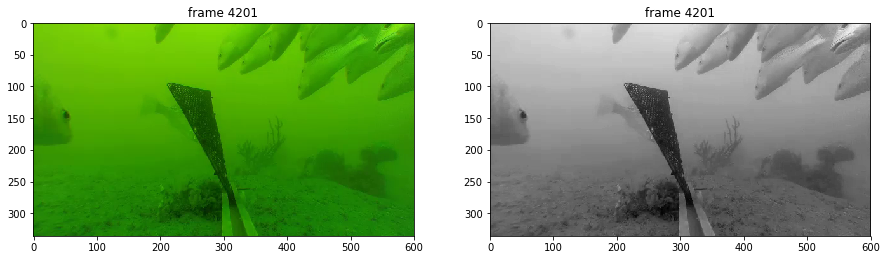

In [108]:
frame=4201
videofilePath='./videos/video1.mp4'
image=getspecificframe(frame,videofilePath) 
displayimage(image,'frame %d' %frame)
exportPath='./exported frames'
outputpath=getexportfolderpath(videofilePath,exportPath)
saveframe(frame,image,outputpath)

## look up & export frames before and after a specific frame  

get frams 1 seconds before and after the frame 4200
return frames from 4175 to 4225 with export rate of 1 frame per second


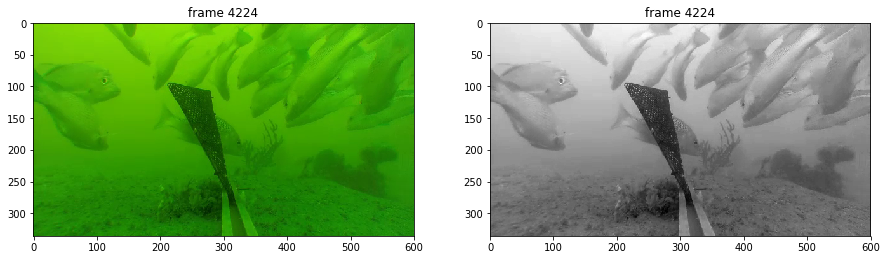

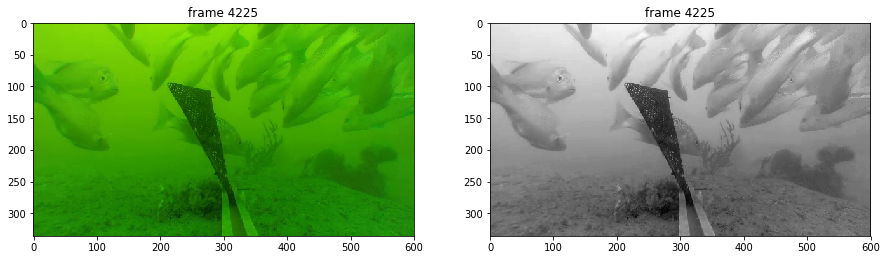

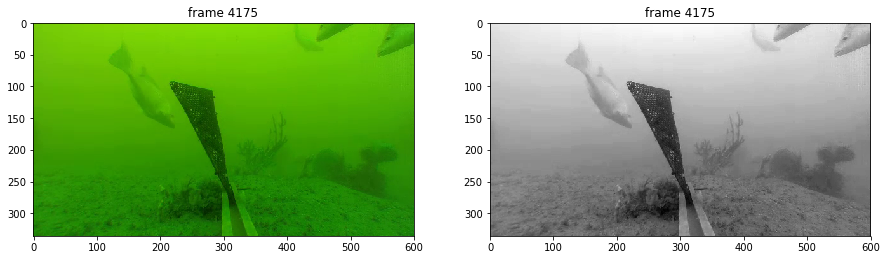

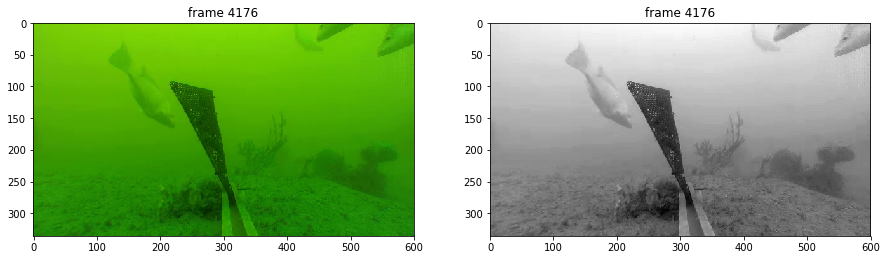

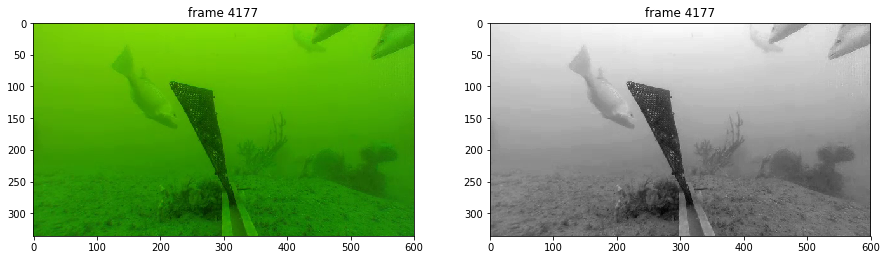

...

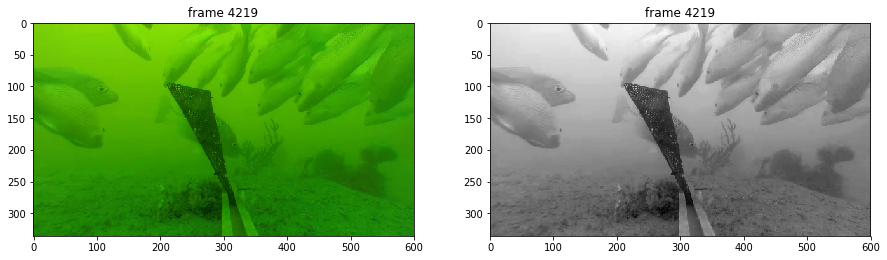

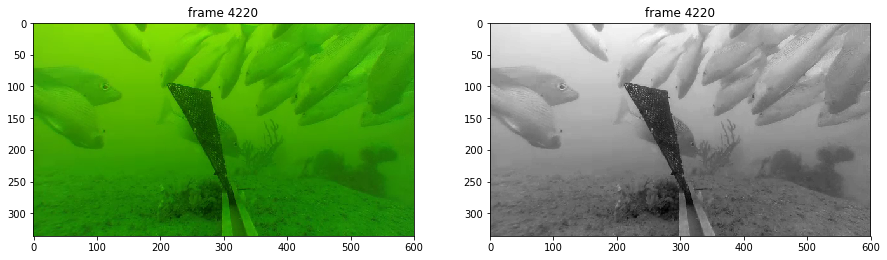

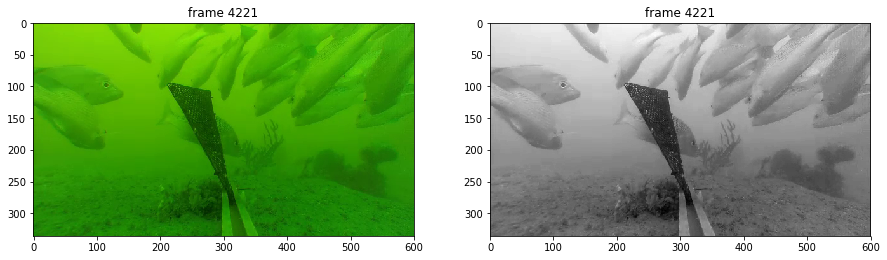

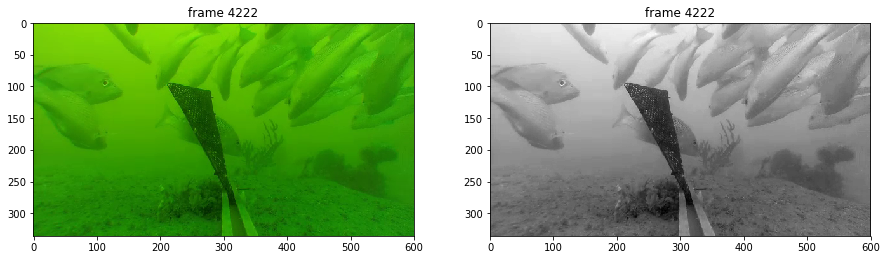

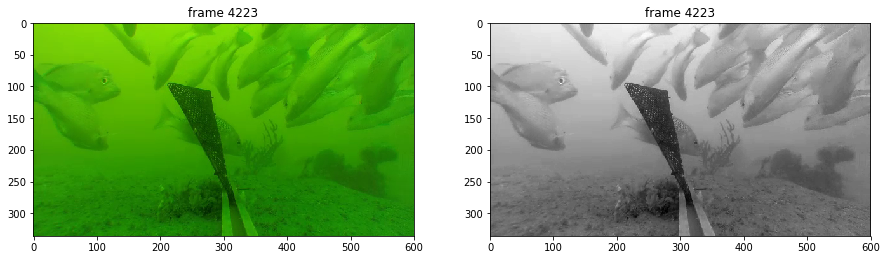

./exported frames/video1


In [112]:
fps=25
sec=1
frame=4200
export_fps=1
videofilePath='./videos/video1.mp4'
print('get frams %d seconds before and after the frame %d' %(sec, frame))
frame_from=  frame - (fps*sec)
frame_to= frame + (fps*sec)
images=getframes(frame_from,frame_to,videofilePath,export_fps) 
for frame,image in images.items():
    displayimage(image,'frame %d' %(frame))

exportPath='./exported frames'
outputpath=getexportfolderpath(videofilePath,exportPath)
print(outputpath)
saveframes(images,outputpath)

## Analyse all the frames after exporting new frames

analysing exported frames from ./exported frames/video1
analysing finished....
85 frames analysed
81 frames detected with fish


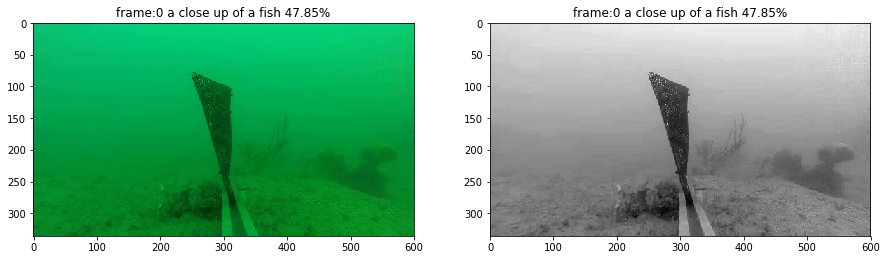

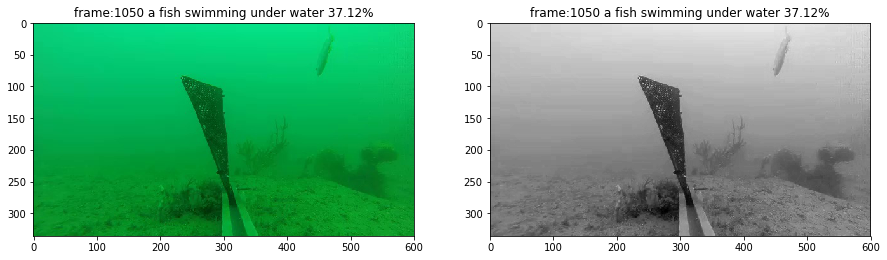

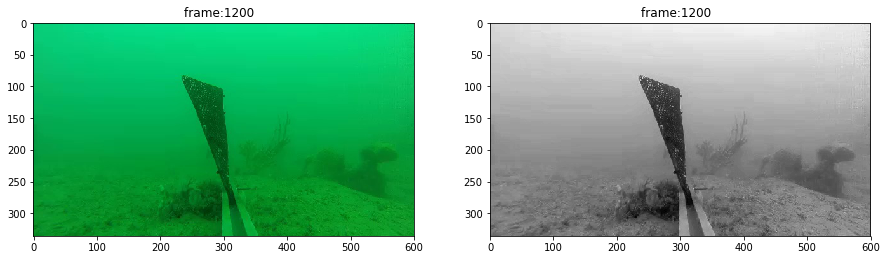

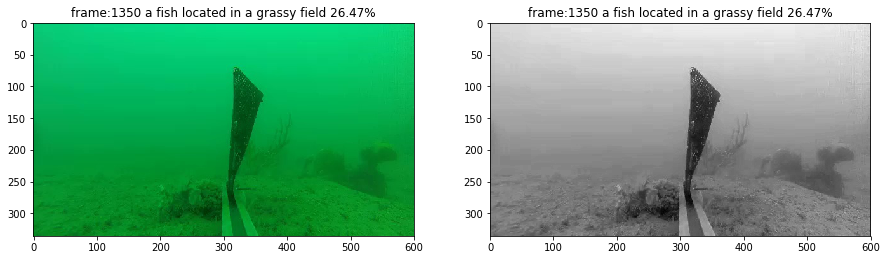

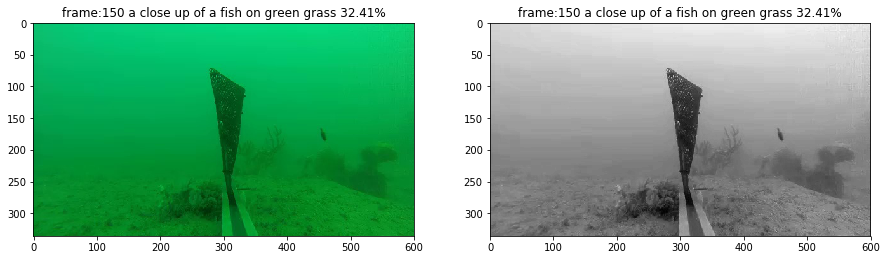

...

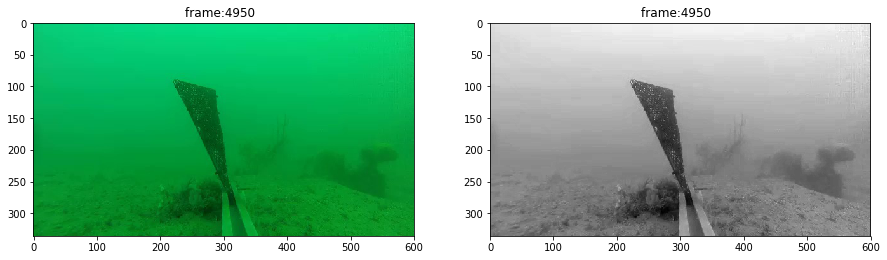

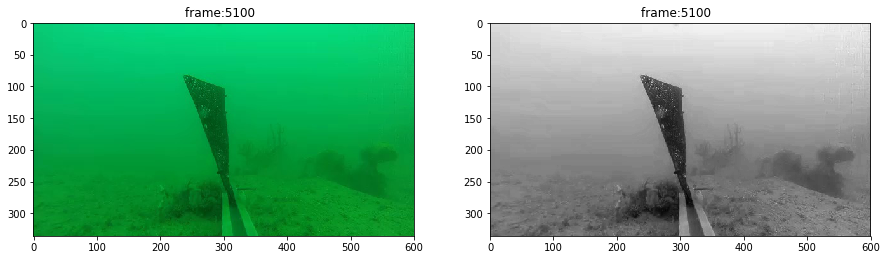

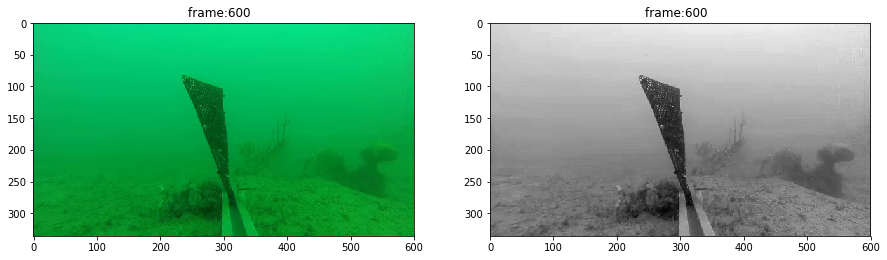

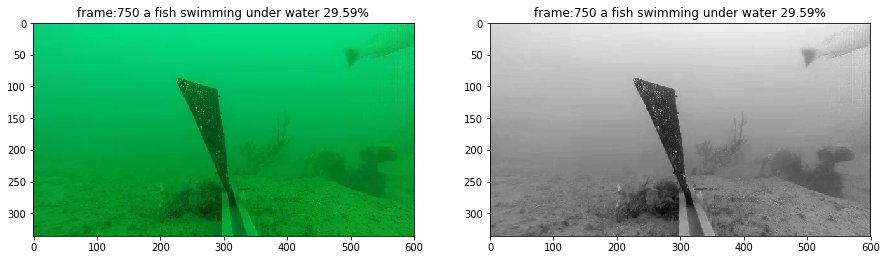

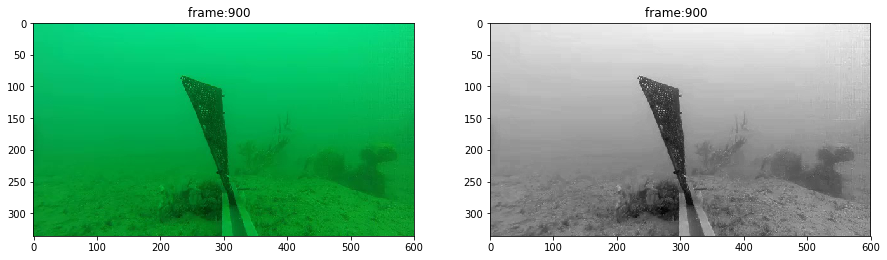

In [113]:
exportPath='./exported frames'
outputpath=getexportfolderpath(videofilePath,exportPath)
df=analyseframes(outputpath)
df['confidence'] =pd.to_numeric( df['confidence'])
total_rows,total_col= df.shape
print('%s frames analysed' % total_rows)
#overwrite previous results
df.to_csv(os.path.join (outputpath,'result.csv'))
result_fish=df[df['tags'].str.contains('fish')]
fish_rows,fish_col= result_fish.shape
print('%s frames detected with fish' % fish_rows)
result_fish.to_csv(os.path.join (outputpath,'result_fish.csv'))
displayresultofanalysedframes(result_fish)  
